In [1]:
%reload_ext autoreload
%autoreload 2
%matplotlib inline

In [2]:
import warnings
warnings.filterwarnings('ignore')

In [3]:
#!pip install --user fastai

In [4]:
import numpy as np
from fastai.vision import *
from fastai.metrics import error_rate
from sklearn import metrics as sk_metrics
from fastai.callbacks import *
import pandas as pd
seed = 2526
np.random.seed(2526)

# Path Setup

In [5]:
version = '9_fixed_merged_top_6'
model = 'resnet50'

#path = '/sfs/qumulo/qhome/sc4xc/ra/Merged_data/Codes'
path = '/Merged_data/Codes'
master_list = path+'/Merged_data.csv'
data_folder = 'Merged_Data'
data_path = path+'/Merged_Data/'

In [6]:
top_genres = ['Drama', 'Comedy', 'Romance', 'Thriller', 'Horror', 'Action']

# Import Data Filenames

In [7]:
master = pd.read_csv(master_list)


master['genre'] = master['genre'].str.replace(' ','')
master = master.loc[master['genre']!='']
print("Before Length",len(master))
#master['genre'] = master['genre'].apply(lambda y: '|'.join([x for x in y.split() if x in top_genres]))
master.head()

Before Length 44370


,movieid,title,genre,movie_fname,liu_data
0,tt0096913,Best of the Best,Action|Drama|Sport|Thriller,tt0096913,1
1,tt0106393,Best of the Best II,Action|Crime|Drama|Thriller,tt0106393,1
2,tt0109040,Ace Ventura: Pet Detective,Comedy,tt0109040,1
3,tt0112281,Ace Ventura: When Nature Calls,Adventure|Comedy,tt0112281,1
4,tt0094137,3 Men and a Baby,Comedy|Drama|Family,tt0094137,1


In [8]:
abcd = [y for i in master['genre'] for y in i.split()]
abcd[0:10]

['Action|Drama|Sport|Thriller',
 'Action|Crime|Drama|Thriller',
 'Comedy',
 'Adventure|Comedy',
 'Comedy|Drama|Family',
 'Comedy|Drama|Family|Romance',
 'Mystery|Thriller',
 'Crime|Drama',
 'Crime|Drama',
 'Crime|Drama']

In [9]:
master['genre'] = [i if i.split('|')[0] in top_genres else '' for i in master['genre']]
master = master.loc[master['genre']!='']
print("after preprocessing", len(master))
# Removing genres not in top_genres
master['genre'] = master['genre'].apply(lambda y: '|'.join([x for x in y.split('|') if x in top_genres]))

after preprocessing 31901


In [10]:
master.shape

(31901, 5)

In [11]:
from os import walk

f = []
for (dirpath, dirnames, filenames) in walk(data_path):
    f.extend(filenames)
    break
    
movieids = [ids.split('.')[0] for ids in f]

In [12]:
master_df = master[['movieid', 'movie_fname', 'genre']].dropna(axis = 0)
# master_df['genre'] = master_df['genre'].apply(lambda x: x.replace(' ',''))
master_df = pd.merge(pd.DataFrame({'movie_fname':movieids}), master_df, on = 'movie_fname', how = 'inner')
master_df = master_df[master_df.movie_fname!='nan']
master_df = master_df[master_df.genre!='nan']
master_df.head()

,movie_fname,movieid,genre
0,tt0090904,tt0090904,Action|Thriller
1,tt0060291,tt0060291,Drama
2,tt3046062,tt3046062,Drama
3,tt0092750,tt0092750,Horror
4,tt0371954,tt0371954,Comedy|Horror


In [13]:
print('We are finally left with {} movies'.format(master_df.shape[0]))

We are finally left with 31569 movies


In [14]:
# master_df = master_df.sample(100)

# Train Test and Validation Split

In [20]:
from sklearn.model_selection import train_test_split

train, test_df = train_test_split(master_df, test_size=0.2, random_state=seed)

train, valid = train_test_split(train, test_size=0.2, random_state=seed)

train['is_train'] = True
valid['is_valid'] = True

train_df = pd.concat([train, valid], sort = False)
train_df.fillna(False, inplace = True)
train_df.head()

,movie_fname,movieid,genre,is_train,is_valid
12466,tt1972819,tt1972819,Drama,True,False
28334,tt2315226,tt2315226,Drama,True,False
15125,tt0134756,tt0134756,Drama,True,False
13510,tt0025699,tt0025699,Action,True,False
12650,tt0081746,tt0081746,Comedy,True,False


In [21]:
# train_df.to_csv('train_posters_'+model+'_'+version+'.csv', index = False)
# test_df.to_csv('test_posters_'+model+'_'+version+'.csv', index = False)

In [15]:
train_df = pd.read_csv('train_posters_'+model+'_'+version+'.csv', keep_default_na=False)
test_df = pd.read_csv('test_posters_'+model+'_'+version+'.csv', keep_default_na=False)
train_df.head()

,movie_fname,movieid,genre,is_train,is_valid
0,tt1972819,tt1972819,Drama,True,False
1,tt2315226,tt2315226,Drama,True,False
2,tt0134756,tt0134756,Drama,True,False
3,tt0025699,tt0025699,Action,True,False
4,tt0081746,tt0081746,Comedy,True,False


# Setting up Data Bunch

In [16]:
bs = 64

In [17]:
train_idxs = train_df['is_train']
valid_idxs = train_df['is_valid']

In [18]:
test_data = ImageList.from_df(test_df, path=path, folder=data_folder, suffix = '.jpg', cols='movie_fname')

data = (ImageList.from_df(train_df, path=path, folder=data_folder, suffix = '.jpg', cols='movie_fname')
                .split_from_df(col = 'is_valid')
                .label_from_df(label_delim='|', cols='genre')
                .add_test(test_data))

data = data.transform(get_transforms(), size=(278,185)).databunch(bs = bs).normalize(imagenet_stats)

In [19]:
data

ImageDataBunch;

Train: LabelList (20204 items)
x: ImageList
Image (3, 278, 185),Image (3, 278, 185),Image (3, 278, 185),Image (3, 278, 185),Image (3, 278, 185)
y: MultiCategoryList
Drama,Drama,Drama,Action,Comedy
Path: /sfs/qumulo/qhome/sc4xc/ra/Merged_data/Merged_data;

Valid: LabelList (5051 items)
x: ImageList
Image (3, 278, 185),Image (3, 278, 185),Image (3, 278, 185),Image (3, 278, 185),Image (3, 278, 185)
y: MultiCategoryList
Drama,Drama,Drama,Drama;Romance,Drama;Thriller
Path: /sfs/qumulo/qhome/sc4xc/ra/Merged_data/Merged_data;

Test: LabelList (6314 items)
x: ImageList
Image (3, 278, 185),Image (3, 278, 185),Image (3, 278, 185),Image (3, 278, 185),Image (3, 278, 185)
y: EmptyLabelList
,,,,
Path: /sfs/qumulo/qhome/sc4xc/ra/Merged_data/Merged_data

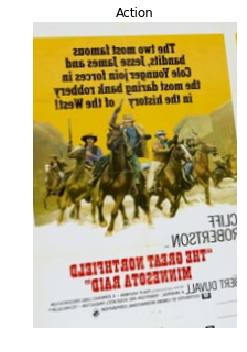

In [20]:
data.show_batch(rows=1, figsize=(7,5))

In [21]:
labels = data.classes
labels

['Action', 'Comedy', 'Drama', 'Horror', 'Romance', 'Thriller']

# Initializing ResNet50

In [22]:
# Defining accuracy measures for multi-label classification
acc_02 = partial(accuracy_thresh, thresh=0.2)
f_score = partial(fbeta, thresh=0.2)


In [23]:
# Initializing Model

learn = cnn_learner(data, models.resnet50, metrics=[acc_02, f_score], callback_fns = [CSVLogger])
epochs = 12

In [74]:
# learn.lr_find()
# learn.recorder.plot()

learn.unfreeze()

In [75]:
from PIL import ImageFile
ImageFile.LOAD_TRUNCATED_IMAGES = True

epochs = 12

for epoch in range(epochs):
    
    print('Epoch :', epoch)
    learn.fit_one_cycle(1)
    learn.save(model+'-stage-1-v'+version+'_'+str(epoch))
    if epoch == 0:
        log_df = learn.csv_logger.read_logged_file()
        log_df['epoch'] = epoch
    else:
        temp_log = learn.csv_logger.read_logged_file()
        temp_log['epoch'] = epoch
        log_df = pd.concat([log_df, temp_log])
    log_df.to_csv(model+'-stage-1-v'+version+'_log.csv')

Epoch : 0


epoch,train_loss,valid_loss,accuracy_thresh,fbeta,time
0,0.483773,0.447368,0.697717,0.712339,08:47


Epoch : 1


epoch,train_loss,valid_loss,accuracy_thresh,fbeta,time
0,0.458350,0.441163,0.695341,0.721288,08:23


Epoch : 2


epoch,train_loss,valid_loss,accuracy_thresh,fbeta,time
0,0.454741,0.445282,0.703656,0.710652,08:23


Epoch : 3


epoch,train_loss,valid_loss,accuracy_thresh,fbeta,time
0,0.456853,0.441675,0.706461,0.713673,08:23


Epoch : 4


epoch,train_loss,valid_loss,accuracy_thresh,fbeta,time
0,0.438707,0.434089,0.705966,0.719349,08:23


Epoch : 5


epoch,train_loss,valid_loss,accuracy_thresh,fbeta,time
0,0.430722,0.429899,0.709200,0.721829,08:22


Epoch : 6


epoch,train_loss,valid_loss,accuracy_thresh,fbeta,time
0,0.424262,0.428215,0.712466,0.724356,08:23


Epoch : 7


epoch,train_loss,valid_loss,accuracy_thresh,fbeta,time
0,0.416515,0.427754,0.716327,0.724015,08:22


Epoch : 8


epoch,train_loss,valid_loss,accuracy_thresh,fbeta,time
0,0.407981,0.429207,0.716624,0.724949,08:22


Epoch : 9


epoch,train_loss,valid_loss,accuracy_thresh,fbeta,time
0,0.404081,0.427496,0.720220,0.724240,08:22


Epoch : 10


epoch,train_loss,valid_loss,accuracy_thresh,fbeta,time
0,0.396184,0.429244,0.726094,0.723347,08:23


Epoch : 11


epoch,train_loss,valid_loss,accuracy_thresh,fbeta,time
0,0.386602,0.431519,0.727612,0.722728,08:23


In [18]:
log_df

NameError: name 'log_df' is not defined

In [24]:
epochs = 12
learn.load(model+'-stage-1-v'+version+'_'+str(epochs-1))

Learner(data=ImageDataBunch;

Train: LabelList (20204 items)
x: ImageList
Image (3, 278, 185),Image (3, 278, 185),Image (3, 278, 185),Image (3, 278, 185),Image (3, 278, 185)
y: MultiCategoryList
Drama,Drama,Drama,Action,Comedy
Path: /sfs/qumulo/qhome/sc4xc/ra/Merged_data/Merged_data;

Valid: LabelList (5051 items)
x: ImageList
Image (3, 278, 185),Image (3, 278, 185),Image (3, 278, 185),Image (3, 278, 185),Image (3, 278, 185)
y: MultiCategoryList
Drama,Drama,Drama,Drama;Romance,Drama;Thriller
Path: /sfs/qumulo/qhome/sc4xc/ra/Merged_data/Merged_data;

Test: LabelList (6314 items)
x: ImageList
Image (3, 278, 185),Image (3, 278, 185),Image (3, 278, 185),Image (3, 278, 185),Image (3, 278, 185)
y: EmptyLabelList
,,,,
Path: /sfs/qumulo/qhome/sc4xc/ra/Merged_data/Merged_data, model=Sequential(
  (0): Sequential(
    (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): 

In [25]:
interp = ClassificationInterpretation.from_learner(learn)

1417 misclassified samples over 5051 samples in the validation set.


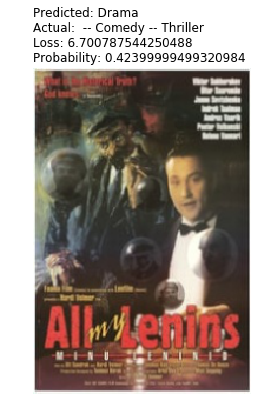

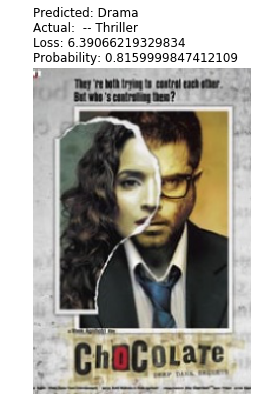

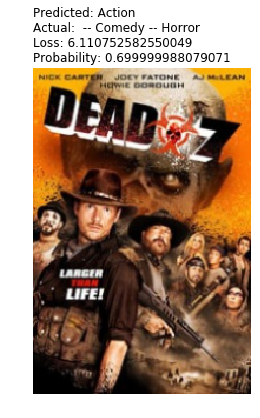

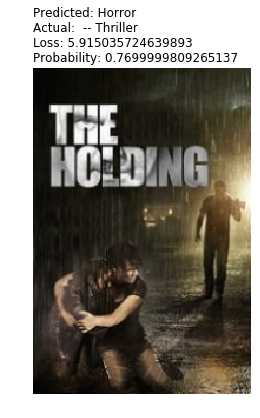

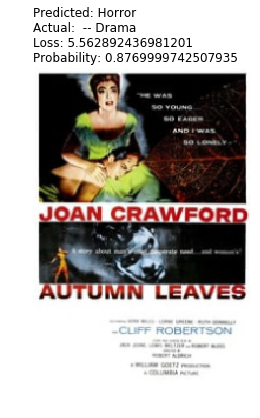

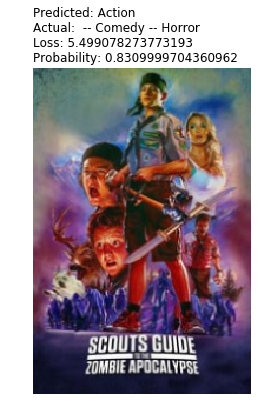

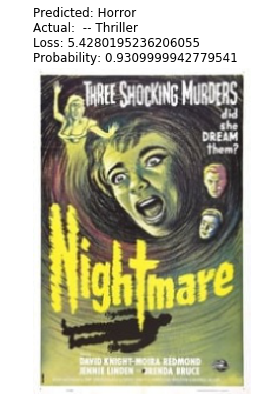

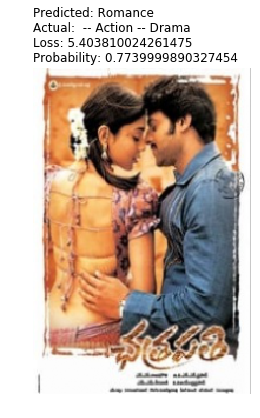

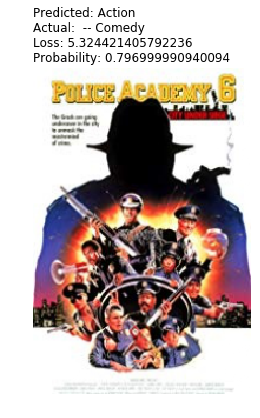

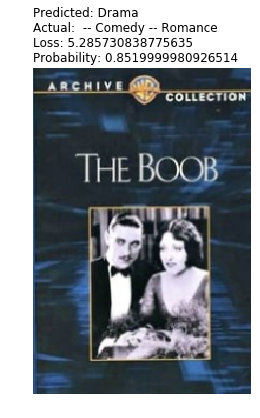

In [26]:
interp.plot_multi_top_losses(10, figsize=(6,6))

# Evaluating on Test Set

In [27]:
# predicting on validation and test sets

y_val = data.valid_ds.y
y_preds_valid = learn.get_preds(ds_type = DatasetType.Valid)
y_preds_test = learn.get_preds(ds_type = DatasetType.Test)

### Getting Validation set Y

In [28]:
# Creating y_valid array out of data bunch object

y_valid = np.zeros([len(y_val), len(labels)])

for row_num in range(len(y_val)):
    for label in str(y_val[row_num]).split(';'):
        label_index = labels.index(label)
        y_valid[row_num, label_index] = 1.0
        
y_valid.sum()

8359.0

### Getting Test Set Y

In [29]:
y_test = test_df['genre']
test_df.head()

,movie_fname,movieid,genre
0,tt0081698,tt0081698,Action|Comedy
1,tt0089243,tt0089243,Action|Drama
2,tt0067949,tt0067949,Comedy
3,tt0899109,tt0899109,Drama
4,tt5889462,tt5889462,Drama


In [31]:
train_df.head()

,movie_fname,movieid,genre,is_train,is_valid
0,tt1972819,tt1972819,Drama,True,False
1,tt2315226,tt2315226,Drama,True,False
2,tt0134756,tt0134756,Drama,True,False
3,tt0025699,tt0025699,Action,True,False
4,tt0081746,tt0081746,Comedy,True,False


In [30]:
y_test

0                        Action|Comedy
1                         Action|Drama
2                               Comedy
3                                Drama
4                                Drama
                     ...              
6309                            Action
6310                          Thriller
6311    Action|Comedy|Thriller|Romance
6312                             Drama
6313                            Comedy
Name: genre, Length: 6314, dtype: object

In [37]:
print(data.classes)
labels = data.classes

preds_prob_test = np.array(y_preds_test[0])
preds_prob_valid = np.array(y_preds_valid[0])

['Action', 'Comedy', 'Drama', 'Horror', 'Romance', 'Thriller']


In [38]:
# [labels.index(label) for label in str(y_val[1]).split(';')]

orig_y_test = np.zeros([len(preds_prob_test), len(preds_prob_test[0])])

for row in range(preds_prob_test.shape[0]):
    label_indices = [labels.index(label) for label in str(y_test[row]).split('|')]
    
    for column in label_indices:
        orig_y_test[row][column] = 1.0
        
y_test = tensor(orig_y_test)

In [39]:
y_test

tensor([[1., 1., 0., 0., 0., 0.],
        [1., 0., 1., 0., 0., 0.],
        [0., 1., 0., 0., 0., 0.],
        ...,
        [1., 1., 0., 0., 1., 1.],
        [0., 0., 1., 0., 0., 0.],
        [0., 1., 0., 0., 0., 0.]], dtype=torch.float64)

In [40]:
# non_zero_preds_prob_test = preds_prob_test[:, [i for i in range(0,25) if i not in [1, 11, 21]]]
# non_zero_y_test = y_test[:, [i for i in range(0,25) if i not in [1, 11, 21]]]

# non_zero_preds_prob_valid = preds_prob_valid[:, [i for i in range(0,25) if i not in [1, 11, 21]]]
# non_zero_y_valid = y_valid[:, [i for i in range(0,25) if i not in [1, 11, 21]]]

non_zero_preds_prob_test = preds_prob_test
non_zero_y_test = y_test

non_zero_preds_prob_valid = preds_prob_valid
non_zero_y_valid = y_valid


In [41]:
y_test.sum(axis = 0)

tensor([1165., 2422., 3434.,  837., 1254., 1264.], dtype=torch.float64)

# AUC from predicted probability

In [50]:
# AUC Macro
sk_metrics.roc_auc_score(non_zero_y_valid, np.array(non_zero_preds_prob_valid))

0.8030626887679909

In [51]:
# AUC Weigthed
sk_metrics.roc_auc_score(non_zero_y_valid, np.array(non_zero_preds_prob_valid), average = 'weighted')

0.7907769580323478

In [52]:
# AUC Weigthed
sk_metrics.roc_auc_score(non_zero_y_valid, np.array(non_zero_preds_prob_valid), average = 'samples')

0.8444719417497085

In [53]:
non_zero_labels = [label for label in labels if label not in ['Adult', 'Film-Noir', 'Talk-Show']]

print('AUC scores:')
for i in range(0, non_zero_preds_prob_valid.shape[1]):
    print(non_zero_labels[i], ':', sk_metrics.roc_auc_score(non_zero_y_valid[:,i], np.array(non_zero_preds_prob_valid[:,i])))

# sk_metrics.roc_auc_score(non_zero_y, np.array(non_zero_preds_prob))

AUC scores:
Action : 0.8229142708690524
Comedy : 0.8218045232755818
Drama : 0.7533315044092973
Horror : 0.8812075113071951
Romance : 0.7508876228222278
Thriller : 0.7882306999245918


# Grid searching for best precision, recall and accuracy and multiple thresholds

In [42]:

def classify(predicted_probs, thresh):

    preds = predicted_probs.copy()
    for i in range(0,len(predicted_probs)):
        for j in range(0,len(predicted_probs[0])):
            if preds[i, j] > thresh: preds[i,j] = 1.0
            else: preds[i,j] = 0.0
    return preds

def genre_accuracy(predicted, actual):
    correctly_classified = (predicted == actual).sum(axis=0)
    return correctly_classified/len(predicted)


In [43]:
def create_df(y_valid, preds, labels):
    st = sk_metrics.classification_report(np.array(y_valid), np.array(preds),  target_names = labels)
    #print(st)
    clsf_lis = [x.split() for x in st.split('\n') if x!=''][1:7]
    #print([x.split() for x in st.split('\n') if x!=''])
    #print(clsf_lis)
    clsf_df = pd.DataFrame(clsf_lis)
    #print(clsf_df.head())
    #print([x.split() for x in st.split('\n') if x!=''][0])
    #print(clsf_df.columns)
    clsf_df.columns = ['genre'] + [x.split() for x in st.split('\n') if x!=''][0]
    return clsf_df

In [44]:
# Trying multiple thresholds

thresholds = np.arange(0, 1, 1e-2)
# thresholds = np.arange(0, 1, 0.5)

for threshold in thresholds:
    preds = classify(preds_prob_valid, threshold)
    accuracy = genre_accuracy(np.array(y_valid), preds)
    clsf_report_df = create_df(y_valid, preds, labels)
    #clsf_report_df = pd.DataFrame(clsf_report).T.reset_index()
    #clsf_report_df.rename({'index' : 'genre'}, axis = 1, inplace = True)
    accuracy_df = pd.DataFrame({'genre': labels,
                                'threshold': threshold,
                                'accuracy': accuracy})
    
    
    temp = pd.merge(accuracy_df, clsf_report_df, on = 'genre', how = 'inner')        
    if threshold == 0:
        summary_df = temp.copy()
    else:
        summary_df = pd.concat([summary_df, temp], ignore_index = False)

/home/sc4xc/.local/lib/python3.6/site-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/sc4xc/.local/lib/python3.6/site-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [64]:
summary_df.reset_index(drop = True, inplace = True)
summary_df.to_pickle('threshold_summary_grid_search_'+model+'_'+version+'.pkl')
summary_df

,genre,threshold,accuracy,precision,recall,f1-score,support
0,Action,0.00,0.183726,0.18,1.00,0.31,928
1,Comedy,0.00,0.380915,0.38,1.00,0.55,1924
2,Drama,0.00,0.559493,0.56,1.00,0.72,2826
3,Horror,0.00,0.129875,0.13,1.00,0.23,656
4,Romance,0.00,0.200752,0.20,1.00,0.33,1014
...,...,...,...,...,...,...,...
595,Comedy,0.99,0.622847,1.00,0.01,0.02,1924
596,Drama,0.99,0.441101,1.00,0.00,0.00,2826
597,Horror,0.99,0.870917,0.83,0.01,0.02,656
598,Romance,0.99,0.799248,0.00,0.00,0.00,1014


In [50]:
import pandas as pd
summary_df = pd.read_pickle('threshold_summary_grid_search_'+model+'_'+version+'.pkl')

In [51]:

def classify_thresholds(predicted_probs, thresh):

    preds = predicted_probs.copy()
    for i in range(0,len(predicted_probs)):
        for j in range(0,len(predicted_probs[0])):
            if preds[i, j] > thresh[j]: preds[i,j] = 1.0
            else: preds[i,j] = 0.0
    return preds


In [52]:
max_metric_for_threhold = 'recall'
summary_df.groupby(['genre'], as_index = False)[max_metric_for_threhold].max()

,genre,recall
0,Action,1.00
1,Comedy,1.00
2,Drama,1.00
3,Horror,1.00
4,Romance,1.00
5,Thriller,1.00


In [53]:
threshold_metrics = ['precision','recall','f1-score', 'accuracy']


for max_metric_for_threhold in threshold_metrics:

    max_metric_grid = summary_df.groupby(['genre'], as_index = False)[max_metric_for_threhold].max()
    thresholds_df = pd.merge(max_metric_grid, summary_df, on = ['genre', max_metric_for_threhold])
    thresholds_df = thresholds_df.groupby(['genre', max_metric_for_threhold], as_index = False)['threshold'].max()

    thresholds = thresholds_df['threshold']

    preds_multi_thresh = classify_thresholds(preds_prob_test, thresholds)

    report_multi_thresh = create_df(y_test, preds_multi_thresh, labels)
    #report_multi_thresh = pd.DataFrame(report).T.reset_index()
    #report_multi_thresh.rename({'index':'genre'}, axis = 1, inplace = True)
    accuracy_multi_thresh = genre_accuracy(np.array(preds_multi_thresh), np.array(y_test))
    accuracy_multi_thresh = pd.DataFrame({'genre':labels, 'accuracy':accuracy_multi_thresh})
    accuracy_multi_thresh = pd.merge(thresholds_df[['genre', 'threshold']], accuracy_multi_thresh, on = 'genre')
    report_multi_thresh = pd.merge(accuracy_multi_thresh, report_multi_thresh, on = 'genre')

    report_multi_thresh.to_csv(max_metric_for_threhold+'_optimized_summary.csv', index = False)

report_multi_thresh

/home/sc4xc/.local/lib/python3.6/site-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/sc4xc/.local/lib/python3.6/site-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


,genre,threshold,accuracy,precision,recall,f1-score,support
0,Action,0.50,0.849699,0.67,0.36,0.47,1165
1,Comedy,0.49,0.766867,0.71,0.66,0.68,2422
2,Drama,0.51,0.690212,0.71,0.73,0.72,3434
3,Horror,0.50,0.903389,0.73,0.44,0.54,837
4,Romance,0.52,0.808996,0.56,0.17,0.27,1254
5,Thriller,0.51,0.818023,0.60,0.28,0.38,1264


In [54]:
preds_multi_thresh.sum(axis=0)

array([ 618., 2244., 3568.,  503.,  388.,  581.], dtype=float32)

In [55]:
print(sk_metrics.classification_report(np.array(y_test), np.array(preds_multi_thresh), target_names = labels))

              precision    recall  f1-score   support

      Action       0.67      0.36      0.47      1165
      Comedy       0.71      0.66      0.68      2422
       Drama       0.71      0.73      0.72      3434
      Horror       0.73      0.44      0.54       837
     Romance       0.56      0.17      0.27      1254
    Thriller       0.60      0.28      0.38      1264

   micro avg       0.69      0.53      0.60     10376
   macro avg       0.66      0.44      0.51     10376
weighted avg       0.68      0.53      0.57     10376
 samples avg       0.69      0.58      0.59     10376



/home/sc4xc/.local/lib/python3.6/site-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


## Hamming Loss

In [56]:
sk_metrics.hamming_loss(y_test, preds_multi_thresh, labels)

/home/sc4xc/.local/lib/python3.6/site-packages/sklearn/metrics/_classification.py:2157: FutureWarning: The labels parameter is unused. It was deprecated in version 0.21 and will be removed in version 0.23
  FutureWarning)


0.19380213282652306

## Jaccard Score

In [57]:
#sk_metrics.jaccard_score(y_test, preds_multi_thresh, average = 'samples')

In [58]:
intersection = (y_test.numpy() * preds_multi_thresh).sum(axis = 1)

union = (y_test.numpy() + preds_multi_thresh).sum(axis = 1) - (y_test.numpy() * preds_multi_thresh).sum(axis = 1)

(intersection/union).mean()

0.5206604371238517

## Subsets Accuracy

In [59]:
n_exact_match = ((y_test.numpy() == preds_multi_thresh).sum(axis = 1) == 6).sum()
n = len(y_test)
n_exact_match / n

0.30962939499524866

## Excel File of model probabilities

In [60]:
all_data = (ImageList.from_df(master_df, path=path, folder=data_folder, suffix = '.jpg', cols='movie_fname')
                .split_none()
                .label_from_df(label_delim='|', cols='genre'))

all_data = all_data.transform(get_transforms(), size=(278,185)).databunch(bs = 16).normalize(imagenet_stats)

In [61]:
learn2 = learn
learn2.data = all_data

all_predictions = learn2.get_preds(ds_type = DatasetType.Train)
all_pred_probs = all_predictions[0].numpy()

In [62]:
all_preds = classify_thresholds(all_pred_probs, thresholds)
all_preds_df = pd.DataFrame(all_preds)
all_preds_df.columns = labels
all_preds_df.head()

,Action,Comedy,Drama,Horror,Romance,Thriller
0,1.0,0.0,0.0,0.0,0.0,1.0
1,0.0,0.0,1.0,0.0,0.0,0.0
2,1.0,0.0,0.0,0.0,0.0,1.0
3,0.0,0.0,1.0,0.0,0.0,0.0
4,0.0,0.0,0.0,1.0,0.0,0.0


In [63]:
all_pred_probs_df = pd.DataFrame(all_pred_probs)
all_pred_probs_df.columns = labels
all_pred_probs_df.head()

,Action,Comedy,Drama,Horror,Romance,Thriller
0,0.744093,0.091496,0.338142,0.089620,0.019771,0.631499
1,0.120302,0.334646,0.678976,0.144768,0.357883,0.248686
2,0.747675,0.208450,0.476035,0.028607,0.092463,0.691994
3,0.167272,0.370673,0.661590,0.007033,0.184492,0.046790
4,0.034035,0.122503,0.495581,0.632918,0.117278,0.447527


In [64]:
all_preds_df = pd.concat([master_df[['movie_fname','movieid']], all_preds_df], axis = 1).dropna()
all_preds_df = all_preds_df.set_index(['movie_fname','movieid']).stack().to_frame()
all_preds_df.columns = ['pred']
all_preds_df

all_pred_probs_df = pd.concat([master_df[['movie_fname','movieid']], all_pred_probs_df], axis = 1).dropna()
all_pred_probs_df = all_pred_probs_df.set_index(['movie_fname','movieid']).stack().to_frame()
all_pred_probs_df.columns = ['pred_prob']
all_pred_probs_df

ranks_df = pd.concat([all_pred_probs_df, all_preds_df], axis = 1)
ranks_df.index.names = ['movie_fname', 'movieid', 'genre']
ranks_df['rank_pred'] = ranks_df.groupby(['movie_fname', 'movieid'])['pred_prob'].rank(method = 'dense', ascending = False)
ranks_df.head()

pred_prob  pred  rank_pred
movie_fname movieid   genre                              
tt0090904   tt0090904 Action    0.744093   1.0        1.0
                      Comedy    0.091496   0.0        4.0
                      Drama     0.338142   0.0        3.0
                      Horror    0.089620   0.0        5.0
                      Romance   0.019771   0.0        6.0

In [65]:
ground_truth = master_df.copy()
ground_truth['genre'] = ground_truth['genre'].apply(lambda x: [y for y in x.split('|')])
ground_truth = ground_truth.set_index(['movie_fname','movieid']).genre.apply(pd.Series).stack().to_frame()
ground_truth.columns = ['genre']
ground_truth.index.names = ['movie_fname', 'movieid','rank_true']
ground_truth = ground_truth.reset_index().set_index(['movie_fname', 'movieid','genre'])
ground_truth['rank_true'] = ground_truth['rank_true']+1.0
ground_truth.head()

rank_true
movie_fname movieid   genre              
tt0090904   tt0090904 Action          1.0
                      Thriller        2.0
tt0060291   tt0060291 Drama           1.0
tt3046062   tt3046062 Drama           1.0
tt0092750   tt0092750 Horror          1.0

In [66]:
ranks_df = pd.concat([ground_truth, ranks_df], axis = 1).dropna(subset = ['pred'])
ranks_df['first_genre_ranked_top'] = ((ranks_df['rank_true']==1) & (ranks_df['rank_pred']==1))*1
ranks_df['first_genre_in_top_2'] = ((ranks_df['rank_true']==1) & ((ranks_df['rank_pred']==1)|(ranks_df['rank_pred']==2)))*1
ranks_df['first_two_genres_ranked_top'] = (((ranks_df['rank_true']==2)|(ranks_df['rank_true']==1)) & (ranks_df['rank_pred']==1))*1
ranks_df['first_two_genres_in_top_2'] = (((ranks_df['rank_true']==2)|(ranks_df['rank_true']==1)) & ((ranks_df['rank_pred']==1)|(ranks_df['rank_pred']==1)))*1
ranks_df['second_genre_ranked_top'] = ((ranks_df['rank_true']==2) & (ranks_df['rank_pred']==1))*1
ranks_df['second_genre_in_top_2'] = ((ranks_df['rank_true']==2) & ((ranks_df['rank_pred']==1)|(ranks_df['rank_pred']==2)))*1
ranks_df


rank_true  pred_prob  pred  rank_pred  \
movie_fname movieid   genre                                             
tt0000003   tt0000003 Action          NaN   0.059085   0.0        5.0   
                      Comedy          1.0   0.615839   1.0        1.0   
                      Drama           NaN   0.596690   1.0        2.0   
                      Horror          NaN   0.041991   0.0        6.0   
                      Romance         NaN   0.234246   0.0        3.0   
...                                   ...        ...   ...        ...   
tt7078926   tt7078926 Comedy          NaN   0.188869   0.0        3.0   
                      Drama           NaN   0.815246   1.0        1.0   
                      Horror          NaN   0.130768   0.0        5.0   
                      Romance         NaN   0.242368   0.0        2.0   
                      Thriller        NaN   0.177262   0.0        4.0   

                                first_genre_ranked_top  first_genre_in_top_2  \
movie_fname movieid   genre                                                    
tt0000003   tt0000003 Action                         0                     0   
                      Comedy                         1                     1   
                      Drama                          0                     0   
                      Horror                         0                     0   
                      Romance                        0                     0   
...                                                ...                   ...   
tt7078926   tt7078926 Comedy                         0                     0   
                      Drama                          0                     0   
                      Horror                         0                     0   
                      Romance                        0                     0   
                      Thriller                       0                     0   

                                first_two_genres_ranked_top  \
movie_fname movieid   genre                                   
tt0000003   tt0000003 Action                              0   
                      Comedy                              1   
                      Drama                               0   
                      Horror                              0   
                      Romance                             0   
...                                                     ...   
tt7078926   tt7078926 Comedy                              0   
                      Drama                               0   
                      Horror                              0   
                      Romance                             0   
                      Thriller                            0   

                                first_two_genres_in_top_2  \
movie_fname movieid   genre                                 
tt0000003   tt0000003 Action                            0   
                      Comedy                            1   
                      Drama                             0   
                      Horror                            0   
                      Romance                           0   
...                                                   ...   
tt7078926   tt7078926 Comedy                            0   
                      Drama                             0   
                      Horror                            0   
                      Romance                           0   
                      Thriller                          0   

                                second_genre_ranked_top  second_genre_in_top_2  
movie_fname movieid   genre                                                     
tt0000003   tt0000003 Action                          0                      0  
                      Comedy                          0                      0  
                      Drama                           0                      0  
                      

In [67]:
std_devs = ranks_df.groupby(['movie_fname','movieid'])['pred_prob'].apply(lambda x: x.std()).to_frame()
std_devs.columns = ['pred_prod_std']
std_devs.head()

,,pred_prod_std
movie_fname,movieid,
tt0000003,tt0000003,0.267363
tt0000005,tt0000005,0.346420
tt0000014,tt0000014,0.132915
tt0000131,tt0000131,0.247892
tt0000242,tt0000242,0.364071


In [68]:
to_excel = \
pd.concat([master_df.set_index(['movie_fname','movieid']),
           ranks_df[['pred_prob','pred']].unstack(),
           std_devs,
           ranks_df.groupby(['movie_fname','movieid'])['first_genre_ranked_top'
                                            ,'first_genre_in_top_2'
                                            ,'first_two_genres_ranked_top'
                                            ,'first_two_genres_in_top_2'
                                            ,'second_genre_ranked_top'
                                            ,'second_genre_in_top_2'].max()
          ], axis = 1).dropna()

to_excel

/opt/conda/lib/python3.6/site-packages/ipykernel/__main__.py:9: FutureWarning: Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.


,,genre,"(pred_prob, Action)","(pred_prob, Comedy)","(pred_prob, Drama)","(pred_prob, Horror)","(pred_prob, Romance)","(pred_prob, Thriller)","(pred, Action)","(pred, Comedy)","(pred, Drama)","(pred, Horror)","(pred, Romance)","(pred, Thriller)",pred_prod_std,first_genre_ranked_top,first_genre_in_top_2,first_two_genres_ranked_top,first_two_genres_in_top_2,second_genre_ranked_top,second_genre_in_top_2
movie_fname,movieid,,,,,,,,,,,,,,,,,,,,
tt0000003,tt0000003,Comedy,0.059085,0.615839,0.596690,0.041991,0.234246,0.087320,0.0,1.0,1.0,0.0,0.0,0.0,0.267363,1.0,1.0,1.0,1.0,0.0,0.0
tt0000005,tt0000005,Drama,0.024403,0.234024,0.911174,0.001686,0.226441,0.025258,0.0,0.0,1.0,0.0,0.0,0.0,0.346420,1.0,1.0,1.0,1.0,0.0,0.0
tt0000014,tt0000014,Comedy,0.344066,0.408890,0.299501,0.384320,0.051391,0.215331,0.0,0.0,0.0,0.0,0.0,0.0,0.132915,1.0,1.0,1.0,1.0,0.0,0.0
tt0000131,tt0000131,Comedy|Horror,0.108410,0.269579,0.714259,0.057306,0.131395,0.100196,0.0,0.0,1.0,0.0,0.0,0.0,0.247892,0.0,1.0,0.0,0.0,0.0,0.0
tt0000242,tt0000242,Horror|Comedy,0.042985,0.042881,0.894845,0.023537,0.588729,0.168944,0.0,0.0,1.0,0.0,1.0,0.0,0.364071,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
tt6990734,tt6990734,Action,0.028895,0.725173,0.690842,0.004425,0.362069,0.035049,0.0,1.0,1.0,0.0,0.0,0.0,0.337071,0.0,0.0,0.0,0.0,0.0,0.0
tt7044010,tt7044010,Comedy,0.023307,0.654569,0.750034,0.004128,0.236318,0.023071,0.0,1.0,1.0,0.0,0.0,0.0,0.337973,0.0,1.0,0.0,0.0,0.0,0.0
tt7068896,tt7068896,Comedy,0.404195,0.067428,0.832136,0.016452,0.167988,0.480380,0.0,0.0,1.0,0.0,0.0,0.0,0.307812,0.0,0.0,0.0,0.0,0.0,0.0


In [70]:
#import pandas as pd
#to_excel = pd.read_csv('top_k_metrics.csv')
to_excel.columns

Index([                      'genre',       ('pred_prob', 'Action'),
             ('pred_prob', 'Comedy'),        ('pred_prob', 'Drama'),
             ('pred_prob', 'Horror'),      ('pred_prob', 'Romance'),
           ('pred_prob', 'Thriller'),            ('pred', 'Action'),
                  ('pred', 'Comedy'),             ('pred', 'Drama'),
                  ('pred', 'Horror'),           ('pred', 'Romance'),
                ('pred', 'Thriller'),               'pred_prod_std',
            'first_genre_ranked_top',        'first_genre_in_top_2',
       'first_two_genres_ranked_top',   'first_two_genres_in_top_2',
           'second_genre_ranked_top',       'second_genre_in_top_2',
                                'D1',                          'D2',
                                'D3',                          'D4'],
      dtype='object')

In [85]:
to_excel.columns[7]

('pred', 'Action')

In [86]:
to_excel['D1'] = 1 - to_excel['first_genre_ranked_top']
to_excel['D2'] = 1 - to_excel['first_genre_in_top_2']
to_excel['D3'] = 1 - to_excel['first_two_genres_ranked_top']
to_excel['D4'] = 1 - to_excel['first_two_genres_in_top_2']
#to_excel['A2'] = to_excel['(\'pred\', \'Action\')'] + to_excel['(\'pred\', \'Comedy\')'] + to_excel['(\'pred\', \'Drama\')'] + to_excel['(\'pred\', \'Horror\')'] + to_excel['(\'pred\', \'Romance\')'] + to_excel['(\'pred\', \'Thriller\')']
to_excel['A2'] = to_excel[to_excel.columns[7]] + to_excel[to_excel.columns[8]] + to_excel[to_excel.columns[9]] + to_excel[to_excel.columns[10]] + to_excel[to_excel.columns[11]] + to_excel[to_excel.columns[12]]
to_excel

,,genre,"(pred_prob, Action)","(pred_prob, Comedy)","(pred_prob, Drama)","(pred_prob, Horror)","(pred_prob, Romance)","(pred_prob, Thriller)","(pred, Action)","(pred, Comedy)","(pred, Drama)",...,first_genre_in_top_2,first_two_genres_ranked_top,first_two_genres_in_top_2,second_genre_ranked_top,second_genre_in_top_2,D1,D2,D3,D4,A2
movie_fname,movieid,,,,,,,,,,,,,,,,,,,,,
tt0000003,tt0000003,Comedy,0.059085,0.615839,0.596690,0.041991,0.234246,0.087320,0.0,1.0,1.0,...,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0
tt0000005,tt0000005,Drama,0.024403,0.234024,0.911174,0.001686,0.226441,0.025258,0.0,0.0,1.0,...,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
tt0000014,tt0000014,Comedy,0.344066,0.408890,0.299501,0.384320,0.051391,0.215331,0.0,0.0,0.0,...,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
tt0000131,tt0000131,Comedy|Horror,0.108410,0.269579,0.714259,0.057306,0.131395,0.100196,0.0,0.0,1.0,...,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,1.0,1.0
tt0000242,tt0000242,Horror|Comedy,0.042985,0.042881,0.894845,0.023537,0.588729,0.168944,0.0,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,2.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
tt6990734,tt6990734,Action,0.028895,0.725173,0.690842,0.004425,0.362069,0.035049,0.0,1.0,1.0,...,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,2.0
tt7044010,tt7044010,Comedy,0.023307,0.654569,0.750034,0.004128,0.236318,0.023071,0.0,1.0,1.0,...,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,1.0,2.0
tt7068896,tt7068896,Comedy,0.404195,0.067428,0.832136,0.016452,0.167988,0.480380,0.0,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0


In [89]:
to_excel = to_excel.reset_index()
to_excel

,movie_fname,movieid,genre,"(pred_prob, Action)","(pred_prob, Comedy)","(pred_prob, Drama)","(pred_prob, Horror)","(pred_prob, Romance)","(pred_prob, Thriller)","(pred, Action)",...,first_genre_in_top_2,first_two_genres_ranked_top,first_two_genres_in_top_2,second_genre_ranked_top,second_genre_in_top_2,D1,D2,D3,D4,A2
0,tt0000003,tt0000003,Comedy,0.059085,0.615839,0.596690,0.041991,0.234246,0.087320,0.0,...,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0
1,tt0000005,tt0000005,Drama,0.024403,0.234024,0.911174,0.001686,0.226441,0.025258,0.0,...,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
2,tt0000014,tt0000014,Comedy,0.344066,0.408890,0.299501,0.384320,0.051391,0.215331,0.0,...,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,tt0000131,tt0000131,Comedy|Horror,0.108410,0.269579,0.714259,0.057306,0.131395,0.100196,0.0,...,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,1.0,1.0
4,tt0000242,tt0000242,Horror|Comedy,0.042985,0.042881,0.894845,0.023537,0.588729,0.168944,0.0,...,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,2.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
31563,tt6990734,tt6990734,Action,0.028895,0.725173,0.690842,0.004425,0.362069,0.035049,0.0,...,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,2.0
31564,tt7044010,tt7044010,Comedy,0.023307,0.654569,0.750034,0.004128,0.236318,0.023071,0.0,...,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,1.0,2.0
31565,tt7068896,tt7068896,Comedy,0.404195,0.067428,0.832136,0.016452,0.167988,0.480380,0.0,...,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0
31566,tt7078780,tt7078780,Horror,0.023066,0.334242,0.875396,0.001843,0.317989,0.024812,0.0,...,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0


In [90]:
to_excel.to_csv('top_k_metrics_new.csv', index = False)

## Analysis

In [88]:
learn.data = data
#learn

In [10]:
prob_genre_test =  pd.DataFrame(preds_prob_test)
prob_genre_test.columns = labels
prob_genre_test = prob_genre_test.reset_index()

prob_genre_test.head()

NameError: name 'preds_prob_test' is not defined

In [81]:
pred_thresh_genre_test =  pd.DataFrame(preds_multi_thresh)
labels_pred = ['Action_pred','Comedy_pred','Drama_pred','Horror_pred','Romance_pred','Thriller_pred']
pred_thresh_genre_test.columns = labels_pred
pred_thresh_genre_test = pred_thresh_genre_test.reset_index()
#pred_thresh_genre_test["Action"] = pred_thresh_genre_test["Action"].astype(int)
for col in labels_pred:
    pred_thresh_genre_test[col] = pred_thresh_genre_test[col].apply(lambda x: int(x) if x == x else "")
pred_thresh_genre_test.head()

,index,Action_pred,Comedy_pred,Drama_pred,Horror_pred,Romance_pred,Thriller_pred
0,0,0,1,0,0,0,0
1,1,0,1,0,0,0,0
2,2,0,1,0,0,0,0
3,3,0,0,1,0,0,0
4,4,0,0,1,0,0,0


In [82]:
test_analysis = pd.read_csv('test_posters_resnet50_9_fixed_merged_top_6.csv')
test_analysis = test_analysis.reset_index()
test_analysis.head()

,index,movie_fname,movieid,genre
0,0,tt0081698,tt0081698,Action|Comedy
1,1,tt0089243,tt0089243,Action|Drama
2,2,tt0067949,tt0067949,Comedy
3,3,tt0899109,tt0899109,Drama
4,4,tt5889462,tt5889462,Drama


In [89]:
test_mix = pd.merge(test_analysis, prob_genre_test , on='index')
test_mix = pd.merge(test_mix, pred_thresh_genre_test, on='index')
test_mix.head()

,index,movie_fname,movieid,genre,Action,Comedy,Drama,Horror,Romance,Thriller,Action_pred,Comedy_pred,Drama_pred,Horror_pred,Romance_pred,Thriller_pred
0,0,tt0081698,tt0081698,Action|Comedy,0.055711,0.861115,0.256132,0.001803,0.135785,0.022949,0,1,0,0,0,0
1,1,tt0089243,tt0089243,Action|Drama,0.316734,0.738391,0.273945,0.033013,0.170511,0.135015,0,1,0,0,0,0
2,2,tt0067949,tt0067949,Comedy,0.004888,0.935240,0.287192,0.000490,0.441604,0.003767,0,1,0,0,0,0
3,3,tt0899109,tt0899109,Drama,0.095307,0.035705,0.919922,0.006293,0.089748,0.379293,0,0,1,0,0,0
4,4,tt5889462,tt5889462,Drama,0.044301,0.312693,0.824235,0.010531,0.358252,0.125970,0,0,1,0,0,0


In [42]:
import glob
path = 'Merged_Data/'
image_glob = glob.glob(path + "/" + "*.jpg")
img_dict = {}


def get_id(filename):
    #print("filename",filename)
    index_s = filename.rfind("/") + 1
    index_f = filename.rfind(".jpg")
    return filename[index_s:index_f]

len(image_glob)

46213

# Poster Analysis per Genre #

**Functions to plot images**

In [43]:
import scipy.misc
#i = 0
for fn in image_glob:
    try:
        #print("fn ",fn)
        #print(i)
        #i =i +1
        #print("get id ",get_id(fn))
        
        img_dict[get_id(fn)] = scipy.misc.imread(fn)
        #print("img ",img_dict[get_id(fn)])
        #print(scipy.misc.imageio.imread(fn))
    except:
        pass
#img_dict

In [50]:
def show_img(imgs):
    
    _, axs = plt.subplots(10, 10, figsize=(15, 15), sharey =True, sharex=True)
    axs = axs.flatten()

    for img, ax in zip(imgs, axs):
        ax.imshow(img)
    plt.subplots_adjust(wspace=0,
                        hspace=0)
    plt.show()
#print(axs)

In [57]:
def genre_df(test_mix, genre, ascend, model_check = False, model_check_value = False):
    col_value = genre+'_pred'
    test_mix['first_genre'] = [i.split('|')[0] for i in test_mix['genre']]
    if model_check & model_check_value:
         
        test_mix = test_mix[(test_mix[col_value] == 1) & (test_mix['first_genre'] == genre)]
        df_val = test_mix.sort_values(by=[genre],ascending=ascend)[0:100]
    elif model_check & (model_check_value == False):
        
        test_mix = test_mix[(test_mix[col_value] == 0) & (test_mix['first_genre'] == genre)]
        df_val = test_mix.sort_values(by=[genre],ascending=ascend)[0:100]
    else:
        
        df_val = test_mix.sort_values(by=[genre],ascending=ascend)[0:100]
    print(df_val[['movieid','genre','first_genre',genre,col_value]].head(10))
    imgs = []
    for i in df_val['movieid']:
        #print(i)
        #print(img_dict[i])
        imgs.append(img_dict[i])
    show_img(imgs)

**Drama Movie Genre**

**Top 100 movies with highest probability of Drama Genre**

In [58]:
test_mix['genre'].head(10)

0                    Action|Comedy
1                     Action|Drama
2                           Comedy
3                            Drama
4                            Drama
5                           Comedy
6                            Drama
7                     Comedy|Drama
8    Action|Drama|Romance|Thriller
9                    Comedy|Horror
Name: genre, dtype: object

        movieid           genre first_genre     Drama  Drama_pred
5553  tt2248739   Drama|Romance       Drama  0.988492           1
3604  tt1241329   Drama|Romance       Drama  0.986487           1
120   tt0838231   Romance|Drama     Romance  0.984213           1
3321  tt2168288           Drama       Drama  0.984047           1
6197  tt4661660    Comedy|Drama      Comedy  0.983692           1
5651  tt0154467           Drama       Drama  0.983270           1
4990  tt0443446           Drama       Drama  0.983248           1
4729  tt1675192  Drama|Thriller       Drama  0.982580           1
353   tt0865297   Drama|Romance       Drama  0.982384           1
3871  tt0109306   Drama|Romance       Drama  0.982131           1


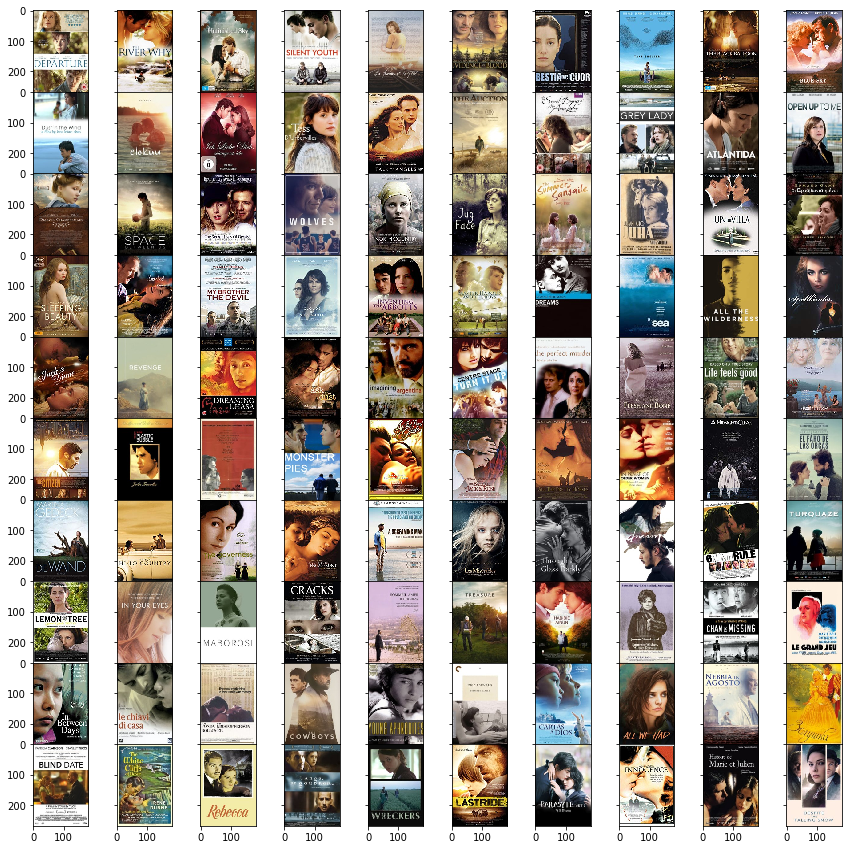

In [59]:
genre_df(test_mix, 'Drama', ascend = False)

**Top 100 movies with highest probability of Drama and First genre is Drama and Model predicted Drama**

        movieid           genre first_genre     Drama  Drama_pred
5553  tt2248739   Drama|Romance       Drama  0.988492           1
3604  tt1241329   Drama|Romance       Drama  0.986487           1
3321  tt2168288           Drama       Drama  0.984047           1
5651  tt0154467           Drama       Drama  0.983270           1
4990  tt0443446           Drama       Drama  0.983248           1
4729  tt1675192  Drama|Thriller       Drama  0.982580           1
353   tt0865297   Drama|Romance       Drama  0.982384           1
3871  tt0109306   Drama|Romance       Drama  0.982131           1
1366  tt0091406   Drama|Romance       Drama  0.982127           1
219   tt1753773           Drama       Drama  0.982066           1


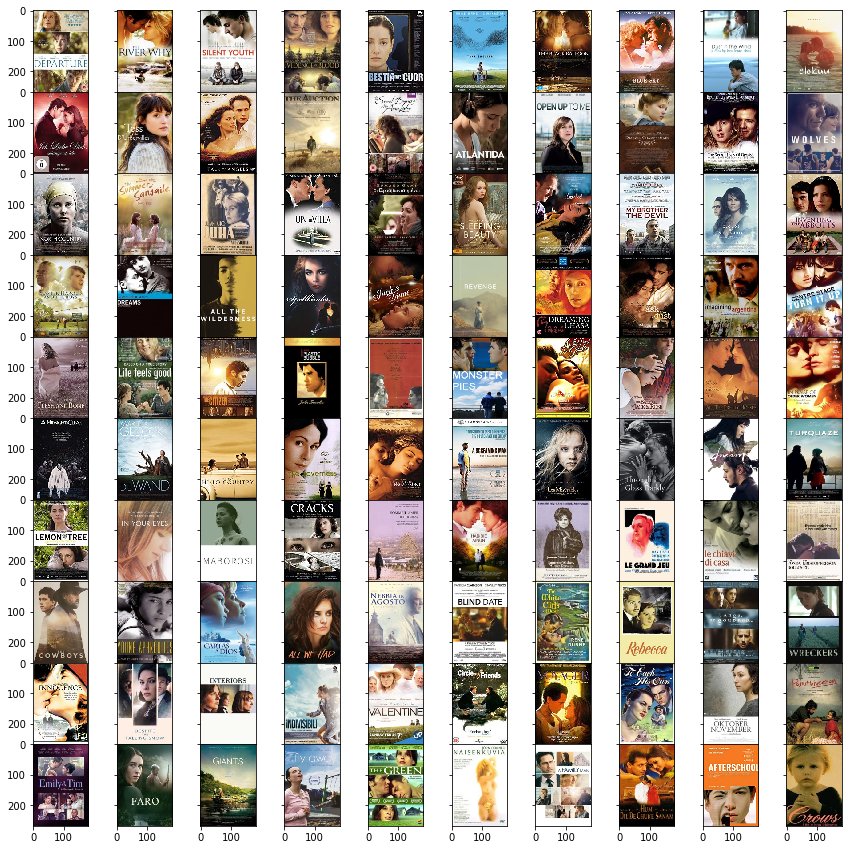

In [197]:
genre_df(test_mix, 'Drama', ascend = False,model_check = True, model_check_value = True )

**Top 100 movies with lowest probability of Drama and First genre is Drama and Model did not predict Drama**

        movieid                         genre first_genre     Drama  \
3586  tt0089714                         Drama       Drama  0.019174   
4445  tt0073922                 Drama|Romance       Drama  0.032283   
3879  tt1078927  Drama|Horror|Thriller|Action       Drama  0.043722   
5030  tt0004635                         Drama       Drama  0.044368   
6293  tt3889450                  Drama|Comedy       Drama  0.047008   
4965  tt0068206                  Drama|Horror       Drama  0.048838   
3291  tt0049130                         Drama       Drama  0.051756   
4962  tt0266078                         Drama       Drama  0.053938   
4040  tt0097883                Drama|Thriller       Drama  0.055066   
1827  tt0451038                         Drama       Drama  0.061631   

      Drama_pred  
3586           0  
4445           0  
3879           0  
5030           0  
6293           0  
4965           0  
3291           0  
4962           0  
4040           0  
1827           0  


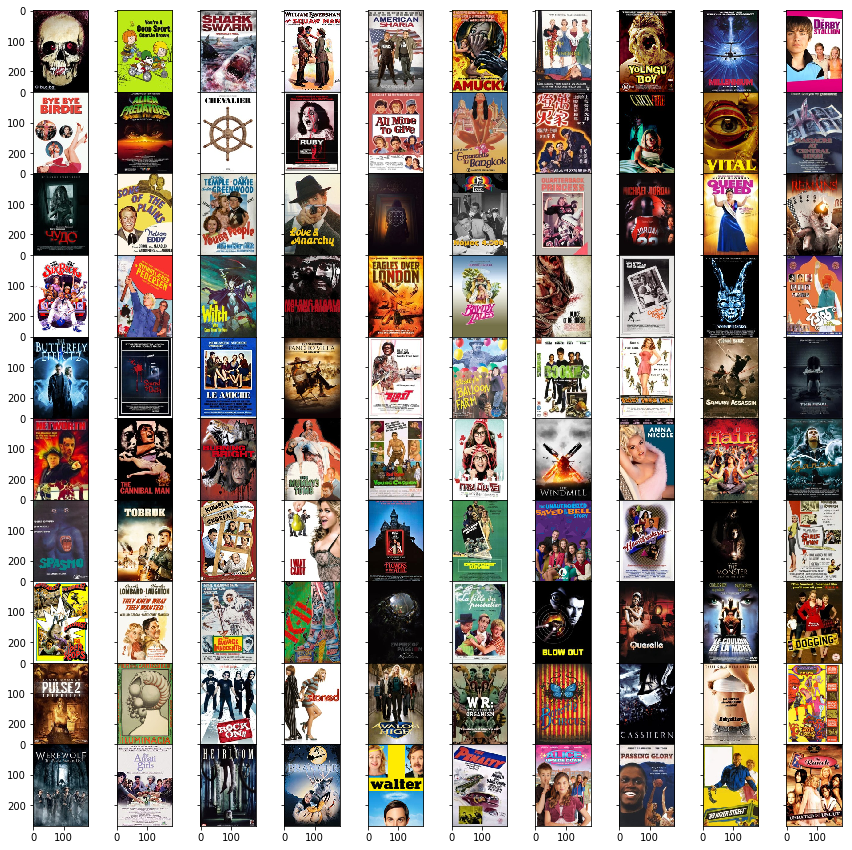

In [198]:
genre_df(test_mix, 'Drama', ascend = True,model_check = True, model_check_value = False)

**Top 100 movies with least probability for Drama Genre**

        movieid                   genre first_genre     Drama  Drama_pred
1897  tt0317303                  Comedy      Comedy  0.003032           0
5507  tt0092608                  Comedy      Comedy  0.005591           0
5917  tt0388183                  Comedy      Comedy  0.005778           0
5284  tt0314786  Action|Comedy|Thriller      Action  0.006244           0
2890  tt0367085                  Comedy      Comedy  0.006271           0
2135  tt0263957            Comedy|Drama      Comedy  0.010269           0
5272  tt0079788                  Horror      Horror  0.010787           0
47    tt0807006                  Comedy      Comedy  0.011877           0
1097  tt0095812                  Horror      Horror  0.012080           0
4618  tt1286785                  Action      Action  0.012677           0


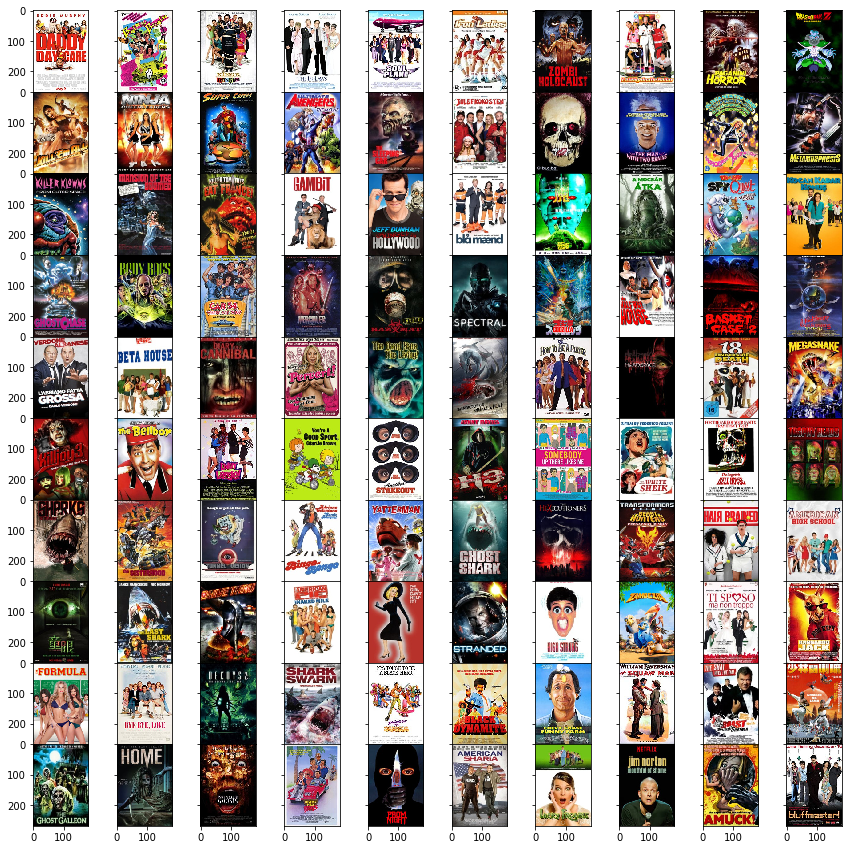

In [199]:
genre_df(test_mix, 'Drama', ascend = True)

**Horror Movie Genre**

**Top 100 movies with highest probability of Horror Genre**

        movieid            genre first_genre    Horror  Horror_pred
5272  tt0079788           Horror      Horror  0.995741            1
3894  tt0417745  Horror|Thriller      Horror  0.993724            1
1336  tt5080804           Horror      Horror  0.993435            1
3586  tt0089714            Drama       Drama  0.991451            1
1097  tt0095812           Horror      Horror  0.989981            1
6045  tt3765892    Comedy|Horror      Comedy  0.987855            1
1682  tt0826817   Horror|Romance      Horror  0.987666            1
1189  tt0099108           Horror      Horror  0.985835            1
5923  tt0225481    Horror|Comedy      Horror  0.984916            1
1215  tt2125685           Horror      Horror  0.981760            1


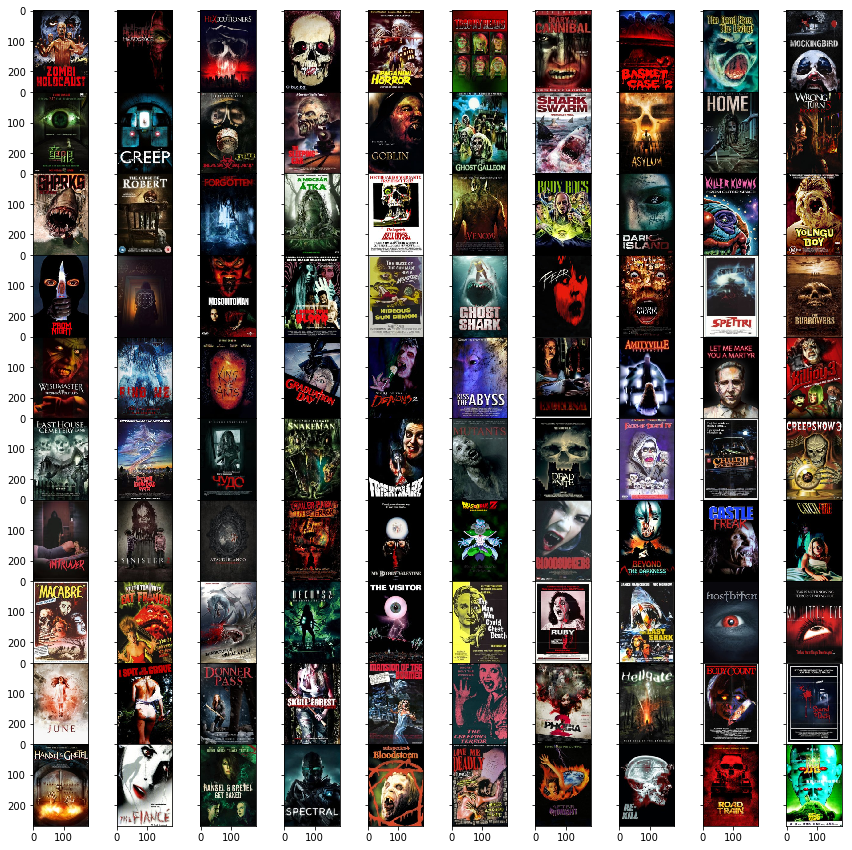

In [200]:
genre_df(test_mix, 'Horror', ascend = False)

**Top 100 movies with lowest probability of Horror Genre**

      index    Action    Comedy     Drama        Horror   Romance  \
5284   5284  0.000097  0.991347  0.006244  3.655115e-11  0.030189   
2890   2890  0.000119  0.993294  0.006271  5.292831e-11  0.034415   
1897   1897  0.000212  0.994257  0.003032  1.720089e-10  0.018752   
1383   1383  0.000128  0.991084  0.041624  3.523536e-10  0.117563   
2135   2135  0.000598  0.991317  0.010269  2.192041e-09  0.053931   

          Thriller movie_fname    movieid                   genre  
5284  8.326366e-07   tt0314786  tt0314786  Action|Comedy|Thriller  
2890  6.860916e-07   tt0367085  tt0367085                  Comedy  
1897  1.612734e-06   tt0317303  tt0317303                  Comedy  
1383  2.090487e-06   tt3651358  tt3651358                  Comedy  
2135  5.312934e-06   tt0263957  tt0263957            Comedy|Drama  


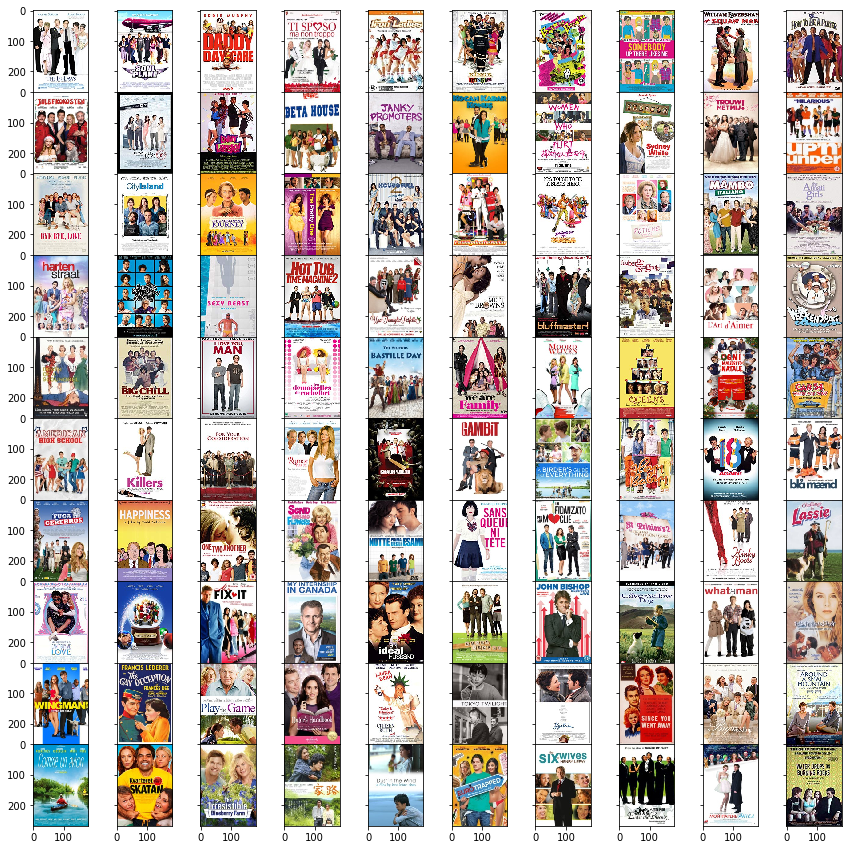

In [122]:
genre_df(test_mix, 'Horror', ascend = True)

**Romance Movie Genre**

**Top 100 movies with highest probability of Romance Genre**

      index    Action    Comedy     Drama    Horror   Romance  Thriller  \
5926   5926  0.002286  0.956627  0.312382  0.000086  0.935080  0.002513   
4505   4505  0.009359  0.810936  0.599738  0.000725  0.864082  0.012887   
4108   4108  0.001075  0.672568  0.645516  0.000289  0.855917  0.004508   
5373   5373  0.001748  0.301094  0.887160  0.000177  0.854705  0.003953   
2272   2272  0.004526  0.290819  0.922759  0.000266  0.848007  0.006990   

     movie_fname    movieid           genre  
5926   tt0122541  tt0122541  Comedy|Romance  
4505   tt0323033  tt0323033  Comedy|Romance  
4108   tt0037384  tt0037384  Comedy|Romance  
5373   tt0025964  tt0025964           Drama  
2272   tt0208196  tt0208196  Comedy|Romance  


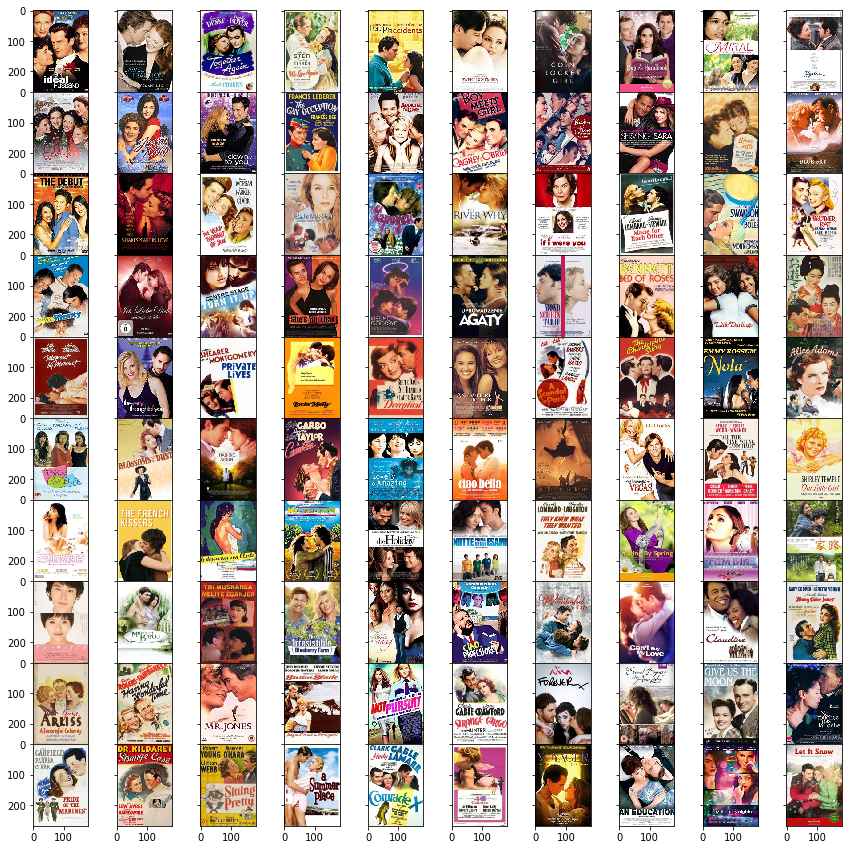

In [124]:
genre_df(test_mix, 'Romance', ascend = False)

**Top 100 movies with lowest probability of Romance Genre**

      index    Action    Comedy     Drama    Horror   Romance  Thriller  \
5272   5272  0.072347  0.106119  0.010787  0.995741  0.001380  0.152094   
2474   2474  0.452195  0.119937  0.022077  0.931477  0.001835  0.232347   
1097   1097  0.065245  0.170090  0.012080  0.989981  0.001875  0.116535   
5201   5201  0.471277  0.057730  0.025659  0.917575  0.001913  0.364549   
3894   3894  0.021982  0.040190  0.030653  0.993724  0.002215  0.489957   

     movie_fname    movieid            genre  
5272   tt0079788  tt0079788           Horror  
2474   tt0076361  tt0076361           Horror  
1097   tt0095812  tt0095812           Horror  
5201   tt2106651  tt2106651  Thriller|Action  
3894   tt0417745  tt0417745  Horror|Thriller  


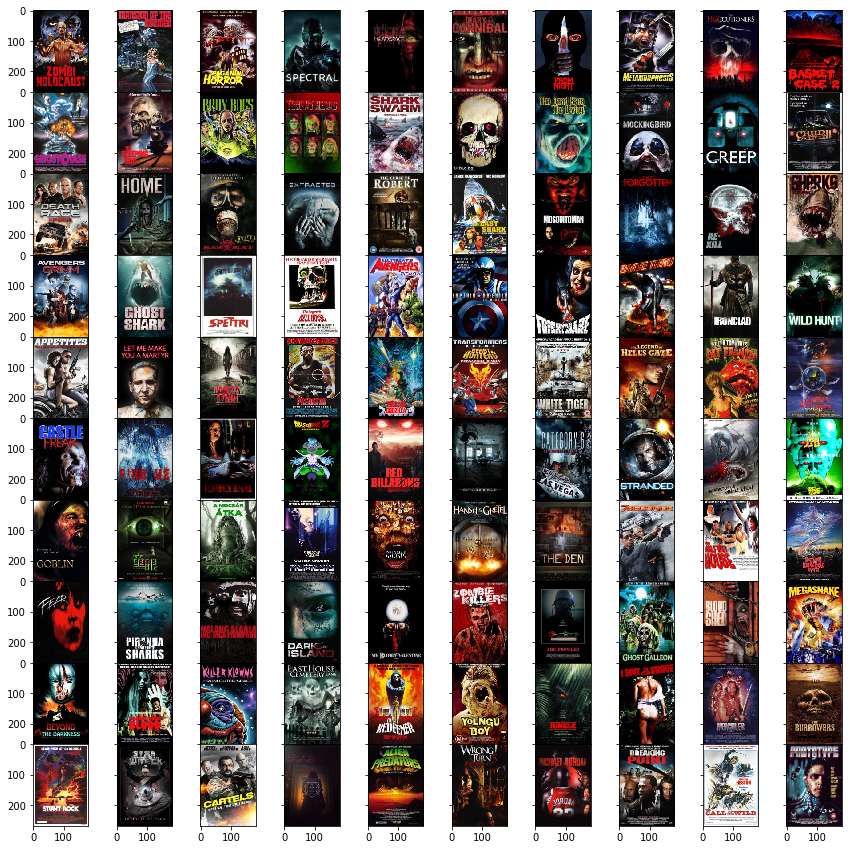

In [125]:
genre_df(test_mix, 'Romance', ascend = True)

**Thriller Movie Genre**

**Top 100 movies with highest probability of Thriller Genre**

      index    Action    Comedy     Drama    Horror   Romance  Thriller  \
315     315  0.971808  0.066725  0.082169  0.038731  0.006488  0.932692   
3864   3864  0.914486  0.062784  0.519387  0.009578  0.026585  0.927915   
3732   3732  0.994977  0.024019  0.177690  0.002469  0.016440  0.926288   
5025   5025  0.912278  0.008874  0.277342  0.078193  0.010459  0.905889   
4734   4734  0.464729  0.029328  0.486417  0.228510  0.051137  0.897520   

     movie_fname    movieid                  genre  
315    tt0107668  tt0107668        Action|Thriller  
3864   tt0257076  tt0257076        Action|Thriller  
3732   tt0317919  tt0317919        Action|Thriller  
5025   tt0286306  tt0286306  Drama|Horror|Thriller  
4734   tt0309593  tt0309593        Horror|Thriller  


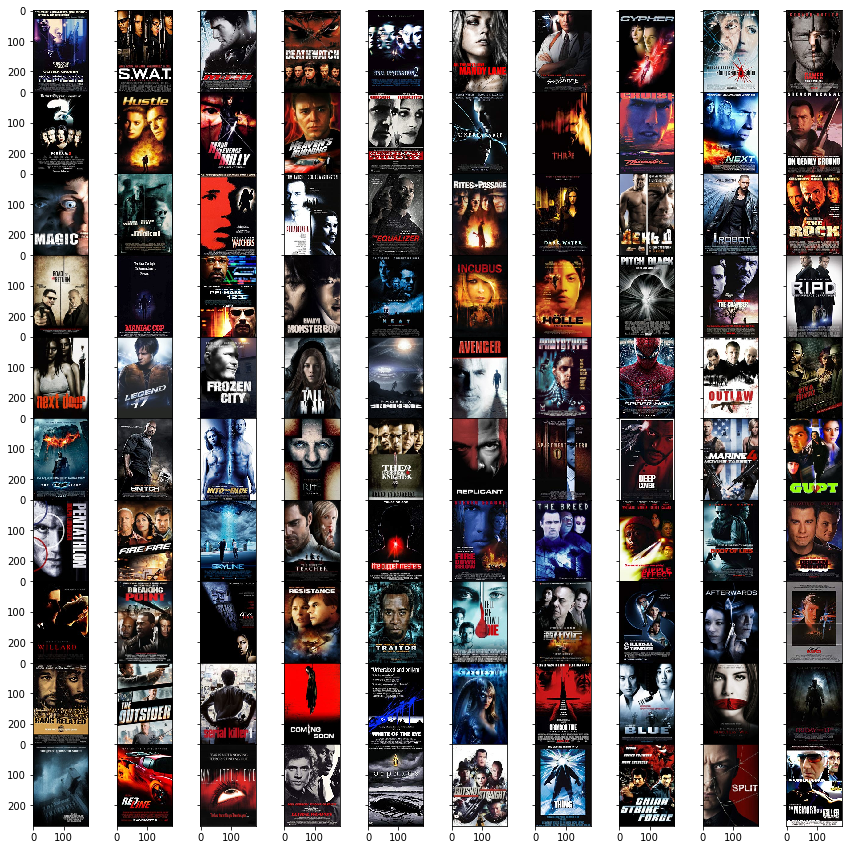

In [126]:
genre_df(test_mix, 'Thriller', ascend = False)

**Top 100 movies with lowest probability of Thriller Genre**

      index    Action    Comedy     Drama        Horror   Romance  \
2890   2890  0.000119  0.993294  0.006271  5.292831e-11  0.034415   
5284   5284  0.000097  0.991347  0.006244  3.655115e-11  0.030189   
1897   1897  0.000212  0.994257  0.003032  1.720089e-10  0.018752   
1383   1383  0.000128  0.991084  0.041624  3.523536e-10  0.117563   
2135   2135  0.000598  0.991317  0.010269  2.192041e-09  0.053931   

          Thriller movie_fname    movieid                   genre  
2890  6.860916e-07   tt0367085  tt0367085                  Comedy  
5284  8.326366e-07   tt0314786  tt0314786  Action|Comedy|Thriller  
1897  1.612734e-06   tt0317303  tt0317303                  Comedy  
1383  2.090487e-06   tt3651358  tt3651358                  Comedy  
2135  5.312934e-06   tt0263957  tt0263957            Comedy|Drama  


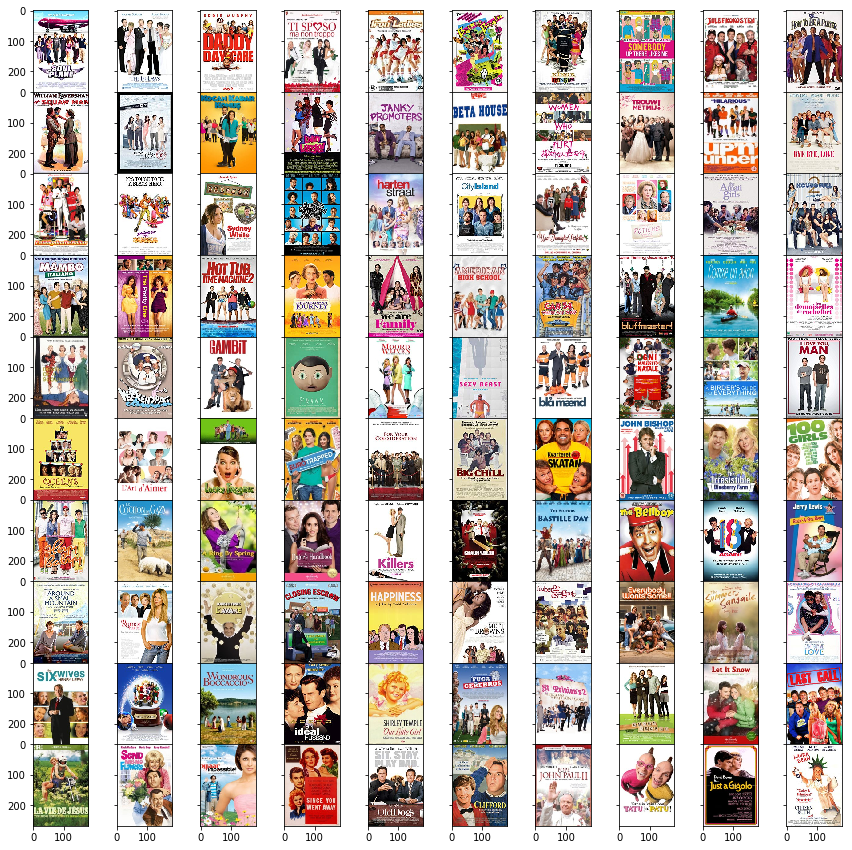

In [127]:
genre_df(test_mix, 'Thriller', ascend = True)

**Comedy Movie Genre**

**Top 100 movies with highest probability of Comedy Genre**

      index    Action    Comedy     Drama        Horror   Romance  Thriller  \
3170   3170  0.007664  0.996629  0.032007  2.573993e-04  0.269323  0.001722   
2830   2830  0.037488  0.996399  0.019373  8.204970e-03  0.046659  0.007508   
5917   5917  0.001336  0.996111  0.005778  1.908396e-08  0.037018  0.000015   
5507   5507  0.001586  0.995598  0.005591  3.006104e-08  0.029981  0.000012   
5769   5769  0.021488  0.995512  0.022675  4.610483e-05  0.054951  0.000938   

     movie_fname    movieid           genre  
3170   tt0053644  tt0053644          Comedy  
2830   tt0085894  tt0085894  Comedy|Romance  
5917   tt0388183  tt0388183          Comedy  
5507   tt0092608  tt0092608          Comedy  
5769   tt1110209  tt1110209          Comedy  


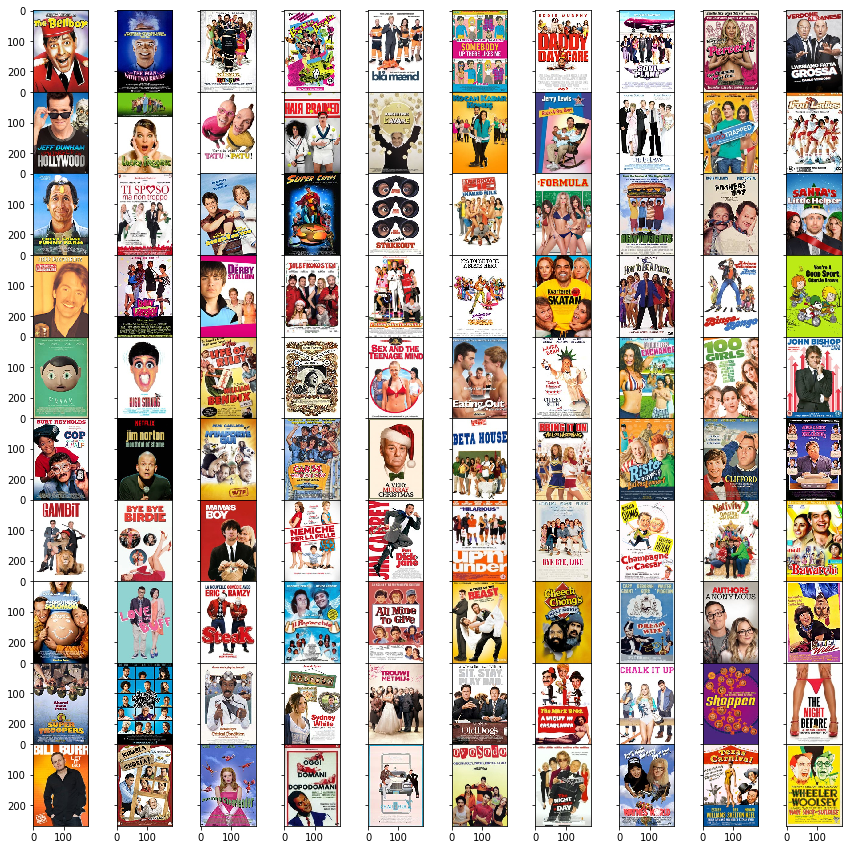

In [128]:
genre_df(test_mix, 'Comedy', ascend = False)

**Top 100 movies with lowest probability of Comedy Genre**

      index    Action    Comedy     Drama    Horror   Romance  Thriller  \
4636   4636  0.012511  0.007009  0.961798  0.032720  0.106709  0.244317   
6060   6060  0.283505  0.007882  0.801457  0.044394  0.072169  0.676175   
3371   3371  0.941221  0.007982  0.585031  0.002207  0.031874  0.393628   
4294   4294  0.202505  0.008275  0.475479  0.348049  0.013355  0.809373   
5025   5025  0.912278  0.008874  0.277342  0.078193  0.010459  0.905889   

     movie_fname    movieid                  genre  
4636   tt2188741  tt2188741         Drama|Thriller  
6060   tt3620418  tt3620418        Thriller|Action  
3371   tt0099127  tt0099127          Romance|Drama  
4294   tt1658837  tt1658837        Horror|Thriller  
5025   tt0286306  tt0286306  Drama|Horror|Thriller  


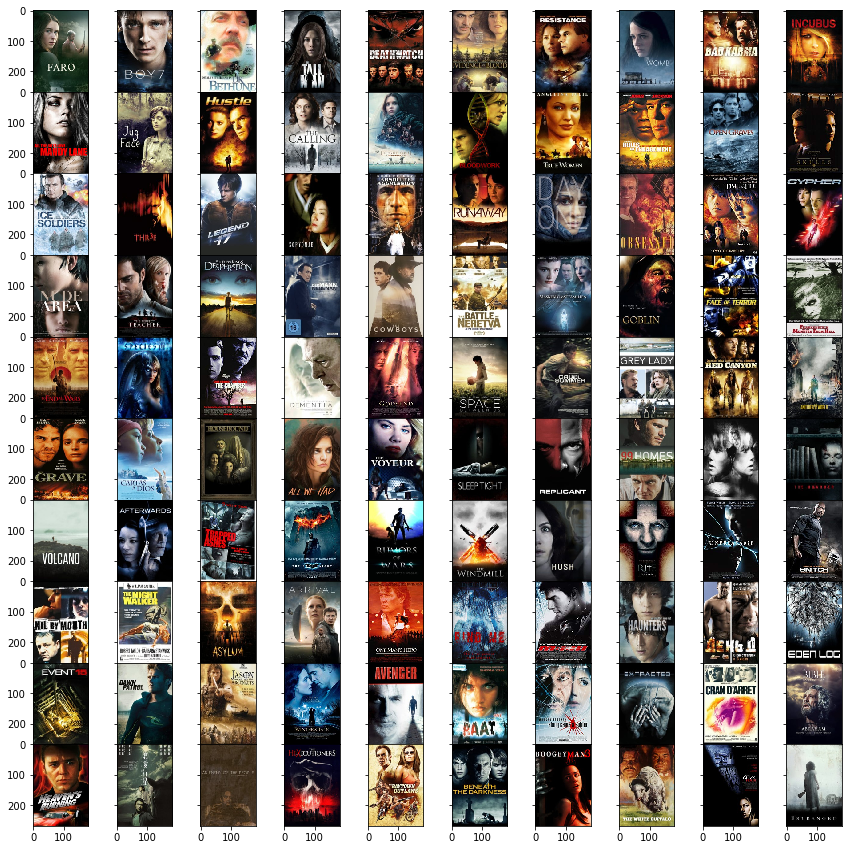

In [129]:
genre_df(test_mix, 'Comedy', ascend = True)

**Action Movie Genre**

**Top 100 movies with lowest probability of Action Genre**

      index    Action    Comedy     Drama    Horror   Romance  Thriller  \
3732   3732  0.994977  0.024019  0.177690  0.002469  0.016440  0.926288   
95       95  0.989564  0.052285  0.058827  0.011772  0.003934  0.544654   
4098   4098  0.983529  0.107728  0.073026  0.005431  0.006711  0.521265   
812     812  0.982460  0.050957  0.212995  0.004710  0.021721  0.784670   
4309   4309  0.979337  0.037629  0.233118  0.005120  0.025299  0.485914   

     movie_fname    movieid            genre  
3732   tt0317919  tt0317919  Action|Thriller  
95     tt1988591  tt1988591  Action|Thriller  
4098   tt0417395  tt0417395  Action|Thriller  
812    tt3528666  tt3528666  Thriller|Action  
4309   tt1691832  tt1691832  Action|Thriller  


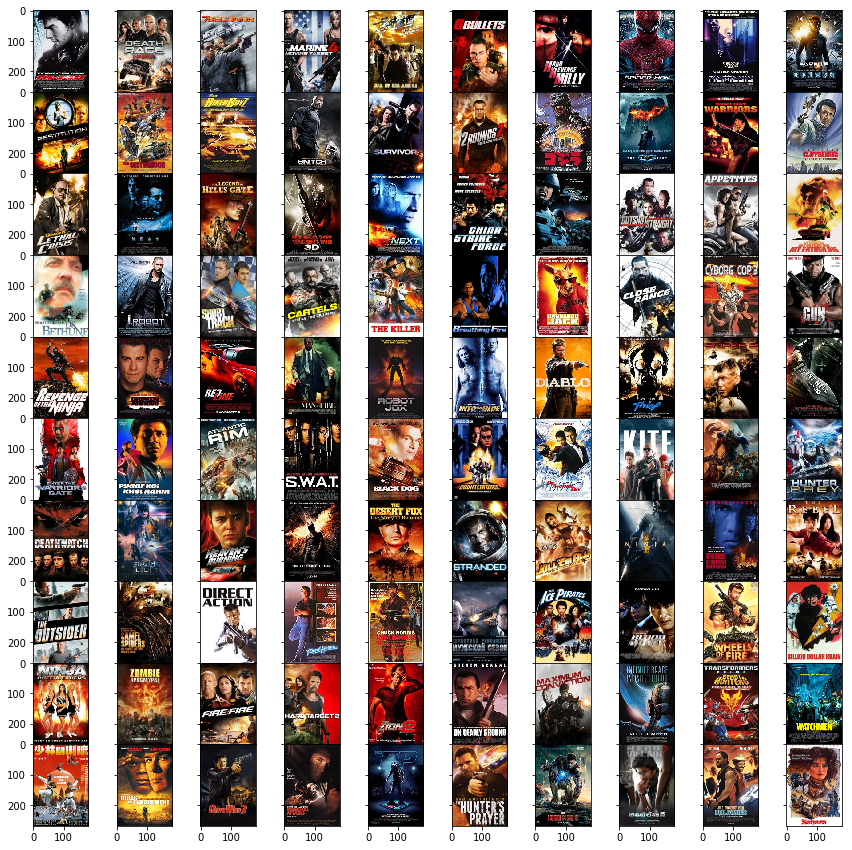

In [130]:
genre_df(test_mix, 'Action', ascend = False)

**Top 100 movies with lowest probability of Action Genre**

      index    Action    Comedy     Drama        Horror   Romance  \
5284   5284  0.000097  0.991347  0.006244  3.655115e-11  0.030189   
2890   2890  0.000119  0.993294  0.006271  5.292831e-11  0.034415   
1383   1383  0.000128  0.991084  0.041624  3.523536e-10  0.117563   
1897   1897  0.000212  0.994257  0.003032  1.720089e-10  0.018752   
2135   2135  0.000598  0.991317  0.010269  2.192041e-09  0.053931   

          Thriller movie_fname    movieid                   genre  
5284  8.326366e-07   tt0314786  tt0314786  Action|Comedy|Thriller  
2890  6.860916e-07   tt0367085  tt0367085                  Comedy  
1383  2.090487e-06   tt3651358  tt3651358                  Comedy  
1897  1.612734e-06   tt0317303  tt0317303                  Comedy  
2135  5.312934e-06   tt0263957  tt0263957            Comedy|Drama  


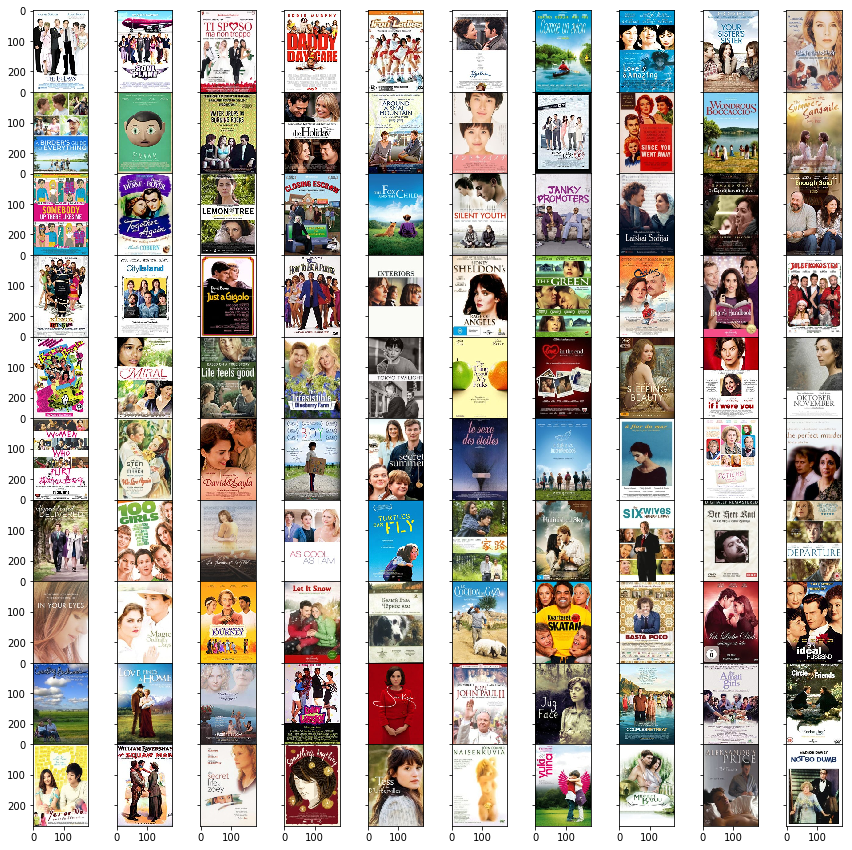

In [131]:
genre_df(test_mix, 'Action', ascend = True)

**Feature Extraction**

In [32]:
layer = learn.model[1][4] 
#model2 = learn.model(include_top = False)
print(layer)

Linear(in_features=4096, out_features=512, bias=True)


In [33]:
class SaveFeatures():
    features=None
    def __init__(self, m): 
        self.hook = m.register_forward_hook(self.hook_fn)
        self.features = None
    def hook_fn(self, module, input, output): 
        out = output.detach().cpu().numpy()
        if isinstance(self.features, type(None)):
            self.features = out
        else:
            self.features = np.row_stack((self.features, out))
    def remove(self): 
        self.hook.remove()
# as told above, Linear layer in which our embeddings are saved in is (4) part
sf = SaveFeatures(learn.model[1][4])

y_try = learn.get_preds(ds_type = DatasetType.Test)

In [34]:
array = sf.features # numpy array
features = array.tolist()

In [35]:
from sklearn.decomposition import PCA

features = np.array(features)
pca = PCA(n_components=300)
pca.fit(features)

PCA(copy=True, iterated_power='auto', n_components=300, random_state=None,
    svd_solver='auto', tol=0.0, whiten=False)

In [36]:
pca_features = pca.transform(features)

In [37]:
images_path = 'Merged_Data'
#images = [os.path.join(dp, f) for dp, dn, filenames in os.walk(images_path) for f in filenames if os.path.splitext(f)[1].lower() in image_extensions]
#images
images = ['Merged_Data/'+rows['movieid']+'.jpg' for index, rows in test_df.iterrows()]


In [38]:
import pickle

pickle.dump([images, pca_features, pca], open('features_resnet.p', 'wb'))

In [39]:
from scipy.spatial import distance
new_pca_features = features[14]
distances = [distance.cosine(new_pca_features, feat) for feat in features]
idx_closest = sorted(range(len(distances)), key=lambda k: distances[k])[0:5]
idx_closest

[14, 2400, 2700, 5042, 1964]

['tt0943326', 'tt0406310', 'tt4071282', 'tt2396436', 'tt0405821']


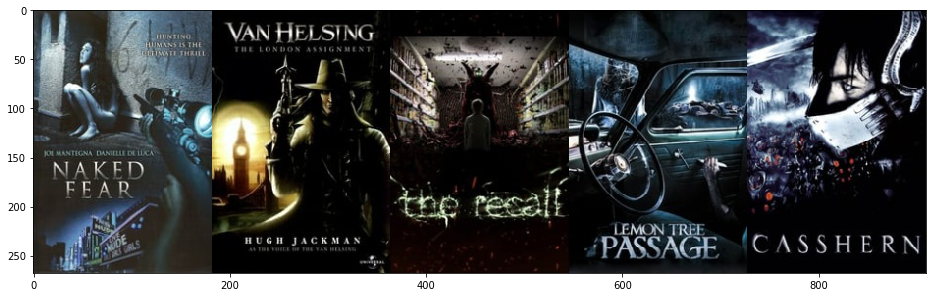

In [44]:
# load all the similarity results as thumbnails of height 100
thumbs = []
movie_id = []
for idx in idx_closest:
    fil = test_df[test_df.index == idx]
    for i in fil['movieid']:
        movie_id.append(i)
    #print("hello",movie_id.movieid)
print(movie_id)
for i in movie_id:
    img = img_dict[i]
    thumbs.append(img)

# concatenate the images into a single image
concat_image = np.concatenate([np.asarray(t) for t in thumbs], axis=1)
# show the image
plt.figure(figsize = (16,12))
plt.imshow(concat_image)

In [45]:
for t in thumbs:
    print(len(t))

268
268
268
268
268
